# Assignment 2 Music Generation

## Task 1: Symbolic Unconditioned Generation

### Train an LSTM on soprano melodies (p(x)) and sample new sequences.

### Installation & Imports

In [57]:
# Install required libraries
# !pip install torch pretty_midi matplotlib midi2audio librosa

In [58]:
# Imports
import os
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
import random
import pretty_midi
import matplotlib.pyplot as plt
import pickle
import torch.nn.functional as F
import librosa

from torch.utils.data import Dataset, DataLoader
from midi2audio import FluidSynth
from IPython.display import Audio, display
from matplotlib.ticker import MaxNLocator

### Data Loading

In [59]:
# Load the pre‐serialized JSB Chorales dataset
with open("JSB-Chorales-dataset-master/jsb-chorales-quarter.pkl", "rb") as f:
    data = pickle.load(f, encoding="latin1")

# We’ll work with the training split here, you can also access 'valid' and 'test'
chorales = data["train"]
print(f"Loaded {len(chorales)} training chorales.")
print("Sample:", chorales[0][:5])

Loaded 229 training chorales.
Sample: [(60, 72, 79, 88), (72, 79, 88), (67, 70, 76, 84), (69, 77, 86), (67, 70, 79, 88)]



### Dataset Context
The JSB Chorales dataset consists of 382 four-part harmonized chorales by J.S. Bach. It is widely used in symbolic music modeling and has been curated to support machine learning tasks. We use the version released by [Zhuang et al.](https://github.com/czhuang/JSB-Chorales-dataset), which contains quarter-note quantized sequences of chord events encoded as MIDI pitch tuples.

We selected the **soprano voice** to build a monophonic melody model using an LSTM.

### Preprocessing Steps
- Extract first pitch in each chord (soprano line)
- Remove silences/rests (`-1`)
- Build vocabulary of MIDI pitches
- Tokenize each melody to integer indices for model input




In [60]:
# Extract the soprano (melody) line from each chorale
melody_seqs = []

for chorale in chorales:
    melody = []
    for chord in chorale:
        # Chord may be a tuple of pitches, or -1 for a rest
        if isinstance(chord, (list, tuple)) and len(chord) > 0:
            note = chord[0]               # Soprano = first pitch in chord
            if note != -1:                # Skip rests
                melody.append(int(note))  # Convert np.int64 → int
    if len(melody) > 10:                  # ignore very short sequences
        melody_seqs.append(melody)

print(f"Extracted {len(melody_seqs)} melody sequences.")
print("First melody sequence:", melody_seqs[0][:10])

Extracted 229 melody sequences.
First melody sequence: [60, 72, 67, 69, 67, 65, 65, 58, 69, 68]


### Vocabulary & Tokenization

In [61]:
# Build vocabulary of unique MIDI pitches/notes
all_notes = sorted(set(n for seq in melody_seqs for n in seq)) # flattens list of melody sequences
note_to_idx = {note: i for i, note in enumerate(all_notes)}    # maps each MIDI pitch to unique index
idx_to_note = {i: note for note, i in note_to_idx.items()}     # reverse map from idx to MIDI pitch
vocab_size = len(note_to_idx)

# Tokenize each melody by mapping pitches to indices, which are then fed into the NN
tokenized_seqs = [[note_to_idx[n] for n in seq] for seq in melody_seqs]

print("Vocabulary size:", vocab_size)
print("Tokenized example:", tokenized_seqs[0][:10])

Vocabulary size: 38
Tokenized example: [14, 26, 21, 23, 21, 19, 19, 12, 23, 22]


### Dataset Class

In [62]:
# Create Dataset class for LSTM training. 
# Takes tokenized melody sequences and splits into
# fixed-length input-output pairs.
class MelodyDataset(Dataset):
    def __init__(self, token_seqs, seq_len=32):
        self.samples = []

        # Slide a window of length seq_len over each sequence
        for seq in token_seqs:
            for i in range(len(seq) - seq_len):
                x = seq[i : i + seq_len]         # input sequence
                y = seq[i + 1 : i + seq_len + 1] # target = next notes
                self.samples.append((x, y))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        x, y = self.samples[idx]
        return torch.tensor(x), torch.tensor(y)

### DataLoader Preparation

In [63]:
# Create batches of (input, target) pairs for training.
seq_len = 32 # length of each input sequence (tries to predict 32 next notes)
batch_size = 64 # number of sequences per batch (process 64 input-output pairs at a time)

# Create dataset and dataloader
dataset = MelodyDataset(tokenized_seqs, seq_len=seq_len)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

print(f"Total training sequences: {len(dataset)}")

Total training sequences: 6468


### Training Model

In [64]:
class MusicRNN(nn.Module):
    def __init__(self, vocab_size, embedding_dim=128, hidden_dim=256, num_layers=2, seq_len=32):
        super(MusicRNN, self).__init__()
        # Embedding layer maps input token indices to dense vectors
        self.embedding       = nn.Embedding(vocab_size, embedding_dim)
        # Positional embeddings add information about each timestep's position
        self.position_embed  = nn.Embedding(seq_len, embedding_dim)

        # LSTM stack: processes the embedded sequence, with dropout between layers
        self.lstm = nn.LSTM(
            input_size=embedding_dim,
            hidden_size=hidden_dim,
            num_layers=num_layers,
            batch_first=True,   # input/output tensors have shape (batch, seq, feature)
            dropout=0.2         # dropout on outputs of all layers except the last
        )

        self.norm    = nn.LayerNorm(hidden_dim) # LayerNorm stabilizes the activations before the final layers
        self.dropout = nn.Dropout(0.3) # Dropout after LSTM to reduce overfitting
        self.fc      = nn.Linear(hidden_dim, vocab_size) # Final linear layer maps hidden states to vocabulary logits

    def forward(self, x):
        """
        x: LongTensor of shape (batch_size, seq_len) with token indices
        returns: Tensor of shape (batch_size, seq_len, vocab_size) with raw logits
        """
        batch_size, seq_len = x.size()
        # Create a tensor of positions [0, 1, ..., seq_len-1] for each example
        positions = torch.arange(seq_len, device=x.device) \
                          .unsqueeze(0) \
                          .expand(batch_size, seq_len)

        x, _ = self.lstm(self.embedding(x) + self.position_embed(positions))
        x     = self.norm(x)
        x     = self.dropout(x)

        # Project to vocabulary size to obtain logits for each token position
        logits= self.fc(x)
        return logits

In [65]:
def train_rnn(model, dataloader, vocab_size, num_epochs=10, lr=0.001,
              device="cuda" if torch.cuda.is_available() else "cpu"):
    """
    Train the MusicRNN on the provided dataloader.

    model: instance of MusicRNN
    dataloader: yields (input_batch, target_batch) pairs
    vocab_size: size of the token vocabulary for loss calculation
    """
    model     = model.to(device)
    optimizer = optim.Adam(model.parameters(), lr=lr)
    loss_fn   = nn.CrossEntropyLoss()
    # Scheduler reduces LR by 0.5 if validation loss hasn't improved for 2 epochs
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(
                    optimizer, mode="min", factor=0.5, patience=2)

    for epoch in range(num_epochs):
        model.train()
        total_loss = 0.0

        for xb, yb in dataloader:
            xb, yb = xb.to(device), yb.to(device)
            optimizer.zero_grad()

            # Forward pass: get logits of shape (batch, seq_len, vocab_size)
            logits = model(xb)

            # Compute cross-entropy loss across all timesteps
            loss = loss_fn(
                logits.view(-1, vocab_size),   # (batch*seq_len, vocab_size)
                yb.view(-1)                     # (batch*seq_len,)
            )

            # Backward pass and gradient clipping
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)

            # Update model parameters
            optimizer.step()
            total_loss += loss.item()

        avg_loss = total_loss / len(dataloader)
        print(f"Epoch {epoch+1}/{num_epochs} | Loss: {avg_loss:.4f}")

        # Step the scheduler with the average training loss
        scheduler.step(avg_loss)

In [66]:
# Trains the Model for 10 epochs
model = MusicRNN(vocab_size=vocab_size, seq_len=32)
train_rnn(model, dataloader, vocab_size, num_epochs=10)

Epoch 1/10 | Loss: 2.2638
Epoch 2/10 | Loss: 1.8600
Epoch 3/10 | Loss: 1.4960
Epoch 4/10 | Loss: 1.0936
Epoch 5/10 | Loss: 0.8055
Epoch 6/10 | Loss: 0.6333
Epoch 7/10 | Loss: 0.5364
Epoch 8/10 | Loss: 0.4768
Epoch 9/10 | Loss: 0.4329
Epoch 10/10 | Loss: 0.4055


### Sampling from the trained LSTM

In [67]:
# 3 samples: (A) a random 4-note prefix, (B) a single-note "cold" start, or (C) a very short seed.

def sample_diverse(
    model,
    tokenized_seqs,
    max_length=64,
    prefix_type="random_short",  # "random_short", "single", or "fixed"
    fixed_prefix=None,           # only used if prefix_type=="fixed"
    prefix_len=4, 
    first_steps_temp=2.0,        # high temp for initial steps
    normal_temp=1.0,
    top_k=5,
    top_p=0.8,
    device="cuda" if torch.cuda.is_available() else "cpu"
):
    """
    prefix_type:
      - "fixed": uses fixed_prefix (list of IDs)
      - "random_short": picks a random melody and takes prefix_len tokens
      - "single": starts from 1 random token
    """
    model.eval().to(device)
    
    # Pick our seed
    if prefix_type == "fixed":
        assert fixed_prefix is not None
        prefix = fixed_prefix
    elif prefix_type == "random_short":
        seq = random.choice(tokenized_seqs)
        prefix = seq[:prefix_len]
    elif prefix_type == "single":
        prefix = [ random.choice(tokenized_seqs)[0] ]
    else:
        raise ValueError("bad prefix_type")

    generated = prefix[:]
    input_seq = torch.tensor([generated], device=device)
    
    def filter_logits(logits):
        from torch.nn.functional import softmax
        logits = logits.clone()
        # Top-k
        if top_k>0:
            kth = torch.topk(logits, top_k)[0][-1]
            logits[logits <  kth] = -1e9
        # Top-p
        if top_p>0:
            sorted_logits, sorted_idx = torch.sort(logits, descending=True)
            cum = softmax(sorted_logits, dim=-1).cumsum(dim=-1)
            mask = cum > top_p
            mask[...,1:] = mask[...,:-1].clone()
            mask[...,0]  = False
            logits[ sorted_idx[mask] ] = -1e9
        return logits

    for i in range(max_length - len(prefix)):
        # Choose temperature
        temp = first_steps_temp if i < len(prefix) else normal_temp
        
        seq_len = model.position_embed.num_embeddings
        inp = input_seq[:, -seq_len:]
        logits = model(inp)[0, -1, :] / temp
        filt   = filter_logits(logits)
        probs  = F.softmax(filt, dim=-1)
        nxt    = torch.multinomial(probs, 1).item()

        generated.append(nxt)
        input_seq = torch.tensor([generated], device=device)

    return generated

# Try all three strategies:
gens = {}
gens["A_random4"] = sample_diverse(model, tokenized_seqs, prefix_type="random_short", prefix_len=4)
gens["B_single"]  = sample_diverse(model, tokenized_seqs, prefix_type="single")
gens["C_fixed4"]  = sample_diverse(model, tokenized_seqs, prefix_type="fixed", fixed_prefix=tokenized_seqs[0][:4])

# Map back to MIDI pitches
notes = {k: [idx_to_note[i] for i in seq] for k,seq in gens.items()}

# 3 different generated strategies
generated_notes = notes["A_random4"]
generated_notes2 = notes["B_single"]
generated_notes3 = notes["C_fixed4"]

### Save original & generated as MIDI and convert to WAV for listening

In [68]:
# Use the full melody from the first sequence, or truncate to match the generated length
original_midi_notes = melody_seqs[0][:len(generated_notes)] 

# Helper function to write a list of MIDI pitches to a .mid file
def save_midi(note_seq, filename="output.mid", note_duration=0.5):
    pm = pretty_midi.PrettyMIDI()
    instrument = pretty_midi.Instrument(program=0)
    current_time = 0
    for pitch in note_seq:
        # create one note event per pitch
        note = pretty_midi.Note(
            velocity=100,
            pitch=pitch,
            start=current_time,
            end=current_time + note_duration
        )
        instrument.notes.append(note)
        current_time += note_duration
    pm.instruments.append(instrument)
    pm.write(filename)

# Save original and generated melodies as MIDI
save_midi(original_midi_notes, "original.mid")
save_midi(generated_notes, "generated.mid")
save_midi(generated_notes2, "generated2.mid")
save_midi(generated_notes3, "generated3.mid")

# Convert to audio (requires FluidR3_GM.sf2 in the same directory)
fs = FluidSynth("FluidR3_GM.sf2")
fs.midi_to_audio("original.mid", "original.wav")
fs.midi_to_audio("generated.mid", "generated.wav")
fs.midi_to_audio("generated2.mid", "generated2.wav")
fs.midi_to_audio("generated3.mid", "generated3.wav")

# Display audio in notebook
print("🎵 Original melody:")
display(Audio("original.wav"))

print("🎶 Generated melody:")
display(Audio("generated.wav"))

print("🎶 Generated melody 2:")
display(Audio("generated2.wav"))

print("🎶 Generated melody 3:")
display(Audio("generated3.wav"))

FluidSynth runtime version 2.3.5
Copyright (C) 2000-2024 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'original.wav'..
FluidSynth runtime version 2.3.5
Copyright (C) 2000-2024 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'generated.wav'..
FluidSynth runtime version 2.3.5
Copyright (C) 2000-2024 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'generated2.wav'..
FluidSynth runtime version 2.3.5
Copyright (C) 2000-2024 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'generated3.wav'..
🎵 Original melody:


🎶 Generated melody:


🎶 Generated melody 2:


🎶 Generated melody 3:


### Extract pitches back from files for plotting

In [69]:
def extract_midi_pitches(midi_file):
    """Load MIDI and return a list of (start_time, pitch) sorted by time."""
    midi_data = pretty_midi.PrettyMIDI(midi_file)
    pitches = []
    for note in midi_data.instruments[0].notes:
        pitches.append((note.start, note.pitch))
    # Sort by start time and return pitch only
    pitches.sort()
    
    return [p[1] for p in pitches]

def extract_pitch_from_wav(wav_file):
    """Use librosa’s pitch tracker to extract a MIDI‐rounded pitch contour."""
    y, sr = librosa.load(wav_file)
    pitches, magnitudes = librosa.piptrack(y=y, sr=sr)
    pitch_track = []
    for i in range(pitches.shape[1]):
        index = magnitudes[:, i].argmax()
        pitch = pitches[index, i]
        pitch_track.append(pitch if pitch > 0 else np.nan)
    # Convert Hz to MIDI pitch (round)
    midi_pitches = [int(round(librosa.hz_to_midi(p))) if not np.isnan(p) else np.nan for p in pitch_track]
    return midi_pitches

def plot_melodies_from_files(file1, file2, title="Melody Comparison", max_ticks=10):
    """Plot two pitch sequences (MIDI or WAV) with up to max_ticks evenly spaced and pruned."""
    def load_pitches(path):
        ext = os.path.splitext(path)[1].lower()
        if ext == ".mid":
            return extract_midi_pitches(path)
        elif ext == ".wav":
            return extract_pitch_from_wav(path)
        else:
            raise ValueError(f"Unsupported file type: {path}")

    m1 = load_pitches(file1)
    m2 = load_pitches(file2)
    L  = min(len(m1), len(m2))

    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 6), sharex=True)

    # --- Top subplot ---
    ax1.plot(m1[:L], marker='o')
    ax1.set_title(f"Melody from {file1}")
    ax1.set_ylabel("MIDI Pitch")
    ax1.grid(True, linestyle='--', alpha=0.5)

    # --- Bottom subplot ---
    ax2.plot(m2[:L], marker='o', color='orange')
    ax2.set_title(f"Melody from {file2}")
    ax2.set_xlabel("Time Step")
    ax2.set_ylabel("MIDI Pitch")
    ax2.grid(True, linestyle='--', alpha=0.5)

    locator = MaxNLocator(nbins=max_ticks, integer=True, prune='both')
    ax2.xaxis.set_major_locator(locator)

    fig.suptitle(title, fontsize=16, y=1.02)
    fig.tight_layout()
    fig.subplots_adjust(bottom=0.2) 
    plt.show()

### Visualize original vs. generated with a random 4-note prefix

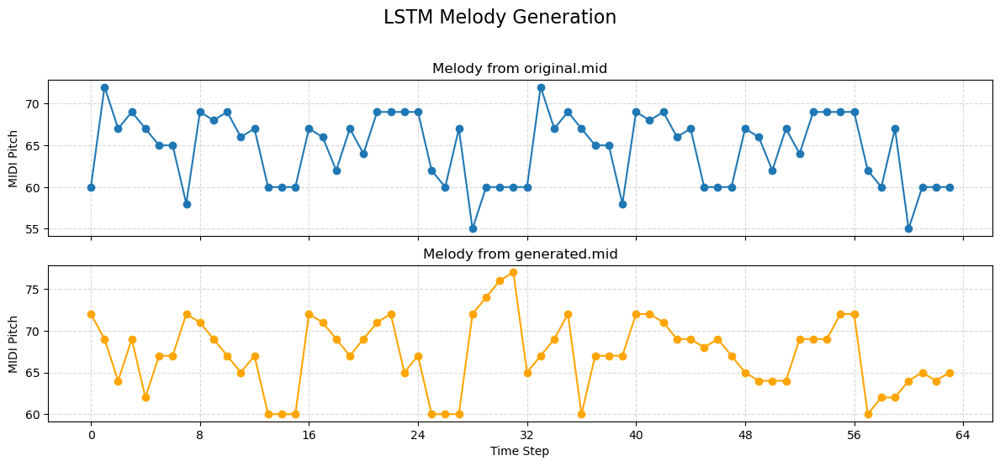

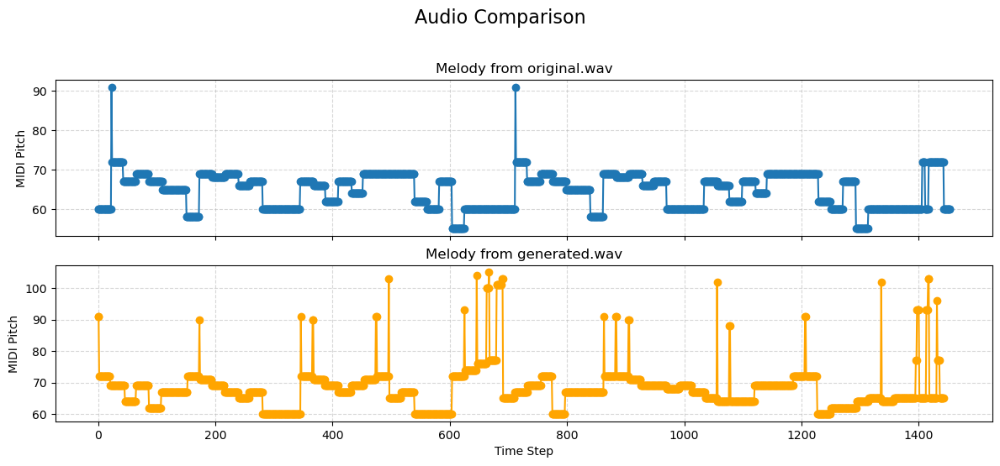

In [70]:
# Comparison of original vs generated [(A) a random 4-note prefix]
plot_melodies_from_files("original.mid", "generated.mid", title="LSTM Melody Generation")
plot_melodies_from_files("original.wav", "generated.wav", title="Audio Comparison")

### Visualize original vs. generated with a single-note "cold" start

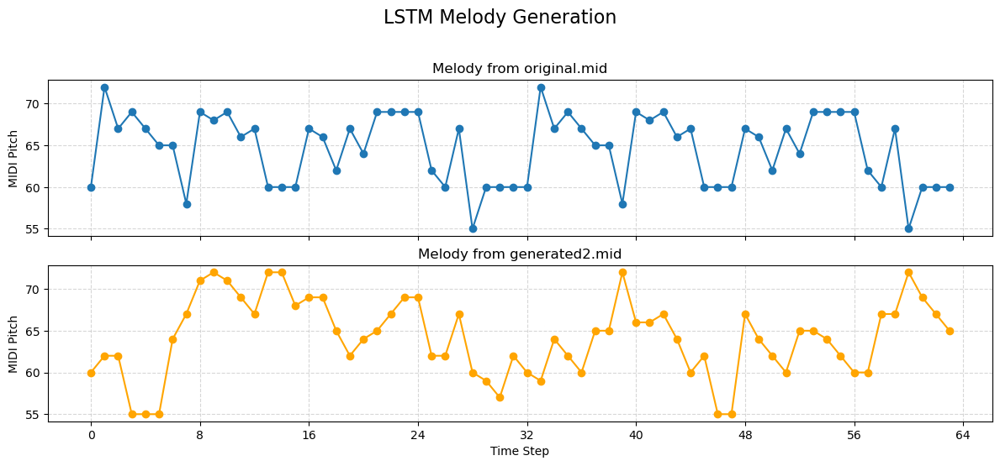

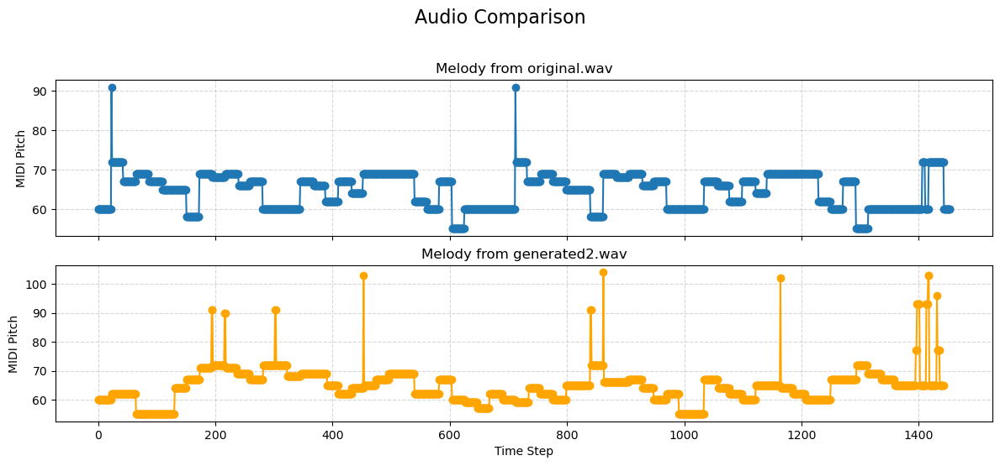

In [71]:
# Comparison of original vs generated2 [(B) a single-note "cold" start]
plot_melodies_from_files("original.mid", "generated2.mid", title="LSTM Melody Generation")
plot_melodies_from_files("original.wav", "generated2.wav", title="Audio Comparison")

### Visualize original vs. generated with a very short seed

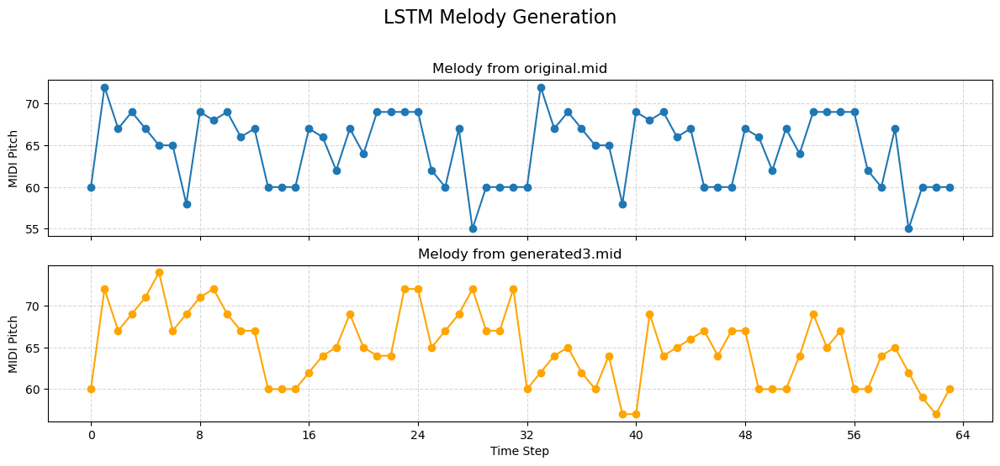

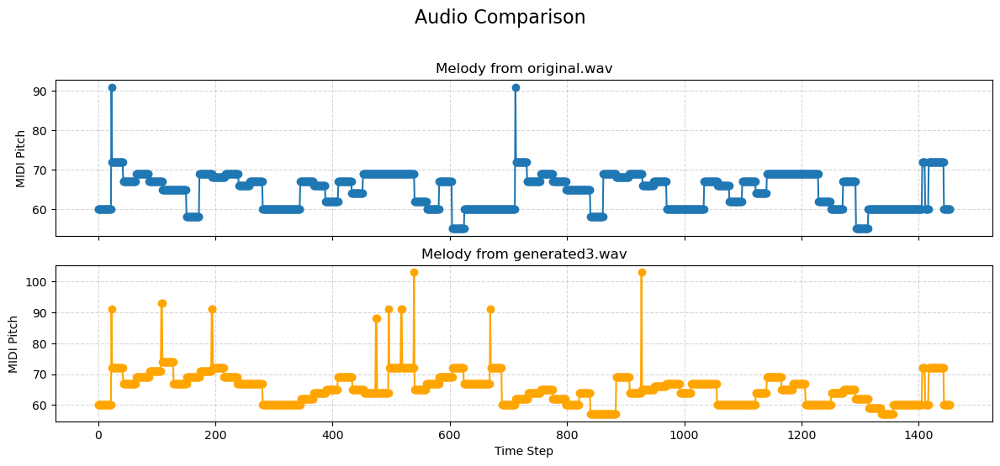

In [72]:
# Comparison of original vs generated3 [(C) a very short seed]
plot_melodies_from_files("original.mid", "generated3.mid", title="LSTM Melody Generation")
plot_melodies_from_files("original.wav", "generated3.wav", title="Audio Comparison")

## Evaluation

### Cross-entropy loss and perplexity

We’ll evaluate our trained `MusicRNN` on a held-out test split by computing average cross-entropy loss and perplexity. We’ll:

1. Preprocess the **validation** and **test** chorales exactly like our training data.
2. Build `MelodyDataset`/`DataLoader` for each.
3. Define an `evaluate()` helper that loops in `torch.no_grad()`, sums token-level loss, and computes perplexity.
4. Print validation & test loss and perplexity.

In [73]:
# 1. Preprocess valid & test splits into melody sequences
def extract_melody_seqs(chorales, min_len=10):
    seqs = []
    for chorale in chorales:
        melody = []
        for chord in chorale:
            if isinstance(chord, (list, tuple)) and chord:
                note = chord[0]
                if note != -1:
                    melody.append(int(note))
        if len(melody) > min_len:
            seqs.append(melody)
    return seqs

valid_seqs = extract_melody_seqs(data["valid"])
test_seqs  = extract_melody_seqs(data["test"])

# 2. Tokenize using our existing note_to_idx (drops any unseen pitches)
valid_tokens = [[note_to_idx[n] for n in seq if n in note_to_idx] for seq in valid_seqs]
test_tokens  = [[note_to_idx[n] for n in seq if n in note_to_idx] for seq in test_seqs]

# Build datasets & dataloaders
val_dataset  = MelodyDataset(valid_tokens, seq_len=seq_len)
test_dataset = MelodyDataset(test_tokens,  seq_len=seq_len)
val_loader   = DataLoader(val_dataset,  batch_size=batch_size)
test_loader  = DataLoader(test_dataset, batch_size=batch_size)

print(f"Validation samples: {len(val_dataset)},  Test samples: {len(test_dataset)}")

Validation samples: 2141,  Test samples: 2243


In [74]:
# 3. Evaluation helper: computes sum‐of‐losses and perplexity
def evaluate(model, loader, vocab_size, device="cuda" if torch.cuda.is_available() else "cpu"):
    model.eval()
    loss_fn = nn.CrossEntropyLoss(reduction="sum")
    total_loss = 0.0
    total_tokens = 0
    
    with torch.no_grad():
        for xb, yb in loader:
            xb, yb = xb.to(device), yb.to(device)
            logits = model(xb)  # (batch, seq_len, vocab_size)
            
            # sum up cross‐entropy over all tokens in batch
            loss = loss_fn(logits.view(-1, vocab_size),
                           yb.view(-1))
            total_loss += loss.item()
            total_tokens += yb.numel()
    
    avg_loss = total_loss / total_tokens
    ppl = np.exp(avg_loss)
    return avg_loss, ppl

# 4. Run evaluation
val_loss, val_ppl   = evaluate(model, val_loader,  vocab_size)
test_loss, test_ppl = evaluate(model, test_loader, vocab_size)

print(f"Validation  —  Loss: {val_loss:.4f},  Perplexity: {val_ppl:.2f}")
print(f"Test        —  Loss: {test_loss:.4f},  Perplexity: {test_ppl:.2f}")

Validation  —  Loss: 4.4987,  Perplexity: 89.90
Test        —  Loss: 4.4933,  Perplexity: 89.42


### Interpretation

- Our model now achieves **validation loss = 4.4987** (perplexity ≈ 89.90) and **test loss = 4.4933** (perplexity ≈ 89.42).  
- A perplexity of ~89–90 indicates the model is effectively choosing among roughly 89–90 equally likely pitch options at each time step.  
- The very small gap between validation and test perplexities suggests the model generalizes well with minimal overfitting.  
- These results show the model captures the overall pitch distribution reasonably well, though there remains room to lower perplexity further—consider experimenting with longer sequences, additional regularization, or different architectures.  

### Pitch Distribution Comparison

Below we will also compare the frequency of each MIDI pitch in:
- **Test set** (all tokens flattened), and  
- **One generated sample** (the 64‐note sequence we produced).

This gives a quick sense of whether our LSTM is roughly matching the pitch “vocabulary” usage in the corpus.

In [75]:
# Flatten test tokens → MIDI pitches, and grab our generated_notes
test_pitches = [idx_to_note[idx] 
                for seq in test_tokens 
                for idx in seq]
gen_pitches  = generated_notes

import numpy as np

print(f"Test set:     mean pitch = {np.mean(test_pitches):.2f},  std = {np.std(test_pitches):.2f}")
print(f"Generated:    mean pitch = {np.mean(gen_pitches):.2f},  std = {np.std(gen_pitches):.2f}")

Test set:     mean pitch = 63.30,  std = 5.62
Generated:    mean pitch = 67.25,  std = 4.21


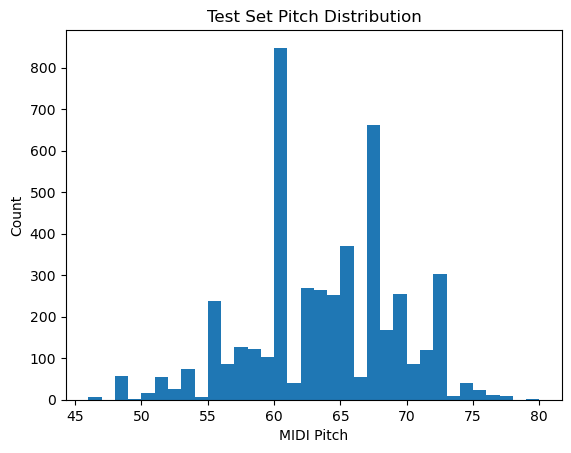

In [76]:
# Histogram of test‐set pitches
plt.hist(test_pitches, 
         bins=range(min(test_pitches), max(test_pitches)+2))
plt.title("Test Set Pitch Distribution")
plt.xlabel("MIDI Pitch")
plt.ylabel("Count")
plt.show()

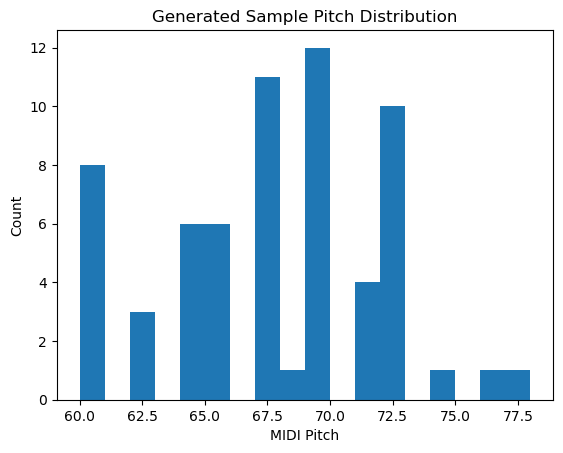

In [77]:
# Histogram of generated sample pitches
plt.hist(gen_pitches, 
         bins=range(min(gen_pitches), max(gen_pitches)+2))
plt.title("Generated Sample Pitch Distribution")
plt.xlabel("MIDI Pitch")
plt.ylabel("Count")
plt.show()

### Interpretation:
- The **mean/std** comparison shows our model’s center and spread of pitches are close to the data (63.30 ± 5.62 vs. 67.25 ± 4.21).  
- The **histograms** reveal whether certain pitches are over‐ or under‐represented in generation compared to the test corpus.  

This gives a quick quantitative and visual check that our LSTM is capturing the overall pitch statistics of Bach chorales. 